<a href="https://colab.research.google.com/github/rihabhamrouni/Machine-Learning/blob/main/Pojet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt

In [9]:
from google.colab import files
files.upload()


Saving datas.csv to datas.csv


{'datas.csv': b',Unnamed: 0,duration (ms),danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,spec_rate,labels,uri\n0,0,195000.0,0.611,0.614,-8.815,0.0672,0.0169,0.000794,0.753,0.52,128.05,3.446153846153846e-07,2,spotify:track:3v6sBj3swihU8pXQQHhDZo\n1,1,194641.0,0.638,0.781,-6.848,0.0285,0.0118,0.00953,0.349,0.25,122.985,1.464234154160737e-07,1,spotify:track:7KCWmFdw0TzoJbKtqRRzJO\n2,2,217573.0,0.56,0.81,-8.029,0.0872,0.0071,7.93e-06,0.241,0.247,170.044,4.007850238770436e-07,1,spotify:track:2CY92qejUrhyPUASawNVRr\n3,3,443478.0,0.525,0.699,-4.571,0.0353,0.0178,8.8e-05,0.0888,0.199,92.011,7.959808603808983e-08,0,spotify:track:11BPfwVbB7vok7KfjBeW4k\n4,4,225862.0,0.367,0.771,-5.863,0.106,0.365,1.47e-06,0.0965,0.163,115.917,4.693131204009528e-07,1,spotify:track:3yUJKPsjvThlcQWTS9ttYx\n5,5,166920.0,0.572,0.837,-7.876,0.0367,0.0197,0.0,0.163,0.627,100.343,2.198658039779536e-07,1,spotify:track:41MOCUNOgWtaYBFUsGnpZ5\n6,6,193133.0,0.725,0.687,-6.465,0

In [10]:
#Charger le dataset
data = pd.read_csv("datas.csv")
print("Dataset shape: ", data.shape)
# Affiche nombre de lignes et colonnes

Dataset shape:  (277938, 15)


In [11]:
print("Répartition des classes:")
print(data['labels'].value_counts(normalize=True))

Répartition des classes:
labels
1    0.382924
0    0.295239
2    0.169336
3    0.152502
Name: proportion, dtype: float64


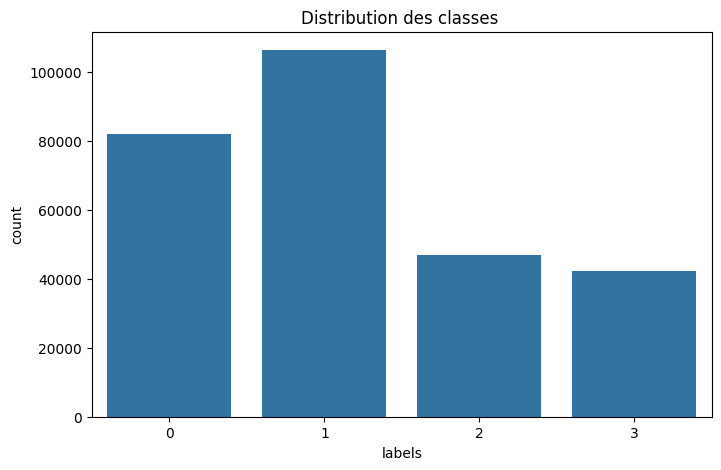

In [12]:
plt.figure(figsize=(8, 5))
sns.countplot(data=data, x='labels')
plt.title('Distribution des classes ')
plt.show()

In [13]:
print(data.columns)

Index(['Unnamed: 0.1', 'Unnamed: 0', 'duration (ms)', 'danceability', 'energy',
       'loudness', 'speechiness', 'acousticness', 'instrumentalness',
       'liveness', 'valence', 'tempo', 'spec_rate', 'labels', 'uri'],
      dtype='object')


In [14]:
# Supprimer colonnes inutiles
data = data.drop(['Unnamed: 0.1', 'Unnamed: 0', 'uri'], axis=1, errors='ignore')

In [15]:
print("Colonnes après suppression :")
print(data.columns)

Colonnes après suppression :
Index(['duration (ms)', 'danceability', 'energy', 'loudness', 'speechiness',
       'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo',
       'spec_rate', 'labels'],
      dtype='object')


In [16]:
# Valeurs min/max
print("valeurs minimales:", data.min())
print("valeurs maximales:", data.max())

valeurs minimales: duration (ms)       6706.0
danceability           0.0
energy                 0.0
loudness             -60.0
speechiness            0.0
acousticness           0.0
instrumentalness       0.0
liveness               0.0
valence                0.0
tempo                  0.0
spec_rate              0.0
labels                 0.0
dtype: float64
valeurs maximales: duration (ms)       3.919895e+06
danceability        9.890000e-01
energy              1.000000e+00
loudness            4.882000e+00
speechiness         9.650000e-01
acousticness        9.960000e-01
instrumentalness    1.000000e+00
liveness            1.000000e+00
valence             1.000000e+00
tempo               2.449470e+02
spec_rate           5.971860e-05
labels              3.000000e+00
dtype: float64


In [17]:
# Séparation X / y
X = data.drop('labels', axis=1)
y = data['labels']

In [21]:
# Split des données
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)


In [22]:
from sklearn.ensemble import RandomForestClassifier
# Modèle Random Forest
model = RandomForestClassifier(
    n_estimators=300,
    random_state=42,
    class_weight='balanced'
)
model.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', n_estimators=300,
                       random_state=42)

In [23]:
# Prédictions
y_pred = model.predict(X_test)

In [24]:
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

Accuracy: 0.940982466239716
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.95      0.95     24562
           1       0.92      0.95      0.94     32049
           2       0.92      0.89      0.90     14068
           3       0.97      0.98      0.98     12703

    accuracy                           0.94     83382
   macro avg       0.94      0.94      0.94     83382
weighted avg       0.94      0.94      0.94     83382



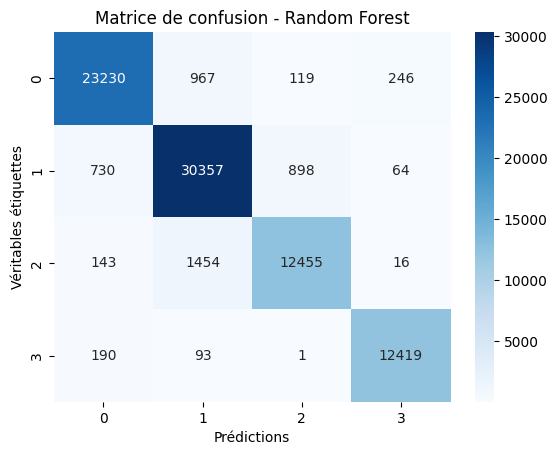

In [25]:
# Matrice de confusion
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(
    cm, annot=True, fmt='d', cmap='Blues',
    xticklabels=np.unique(y),
    yticklabels=np.unique(y)
)
plt.xlabel('Prédictions')
plt.ylabel('Véritables étiquettes')
plt.title('Matrice de confusion - Random Forest')
plt.show()

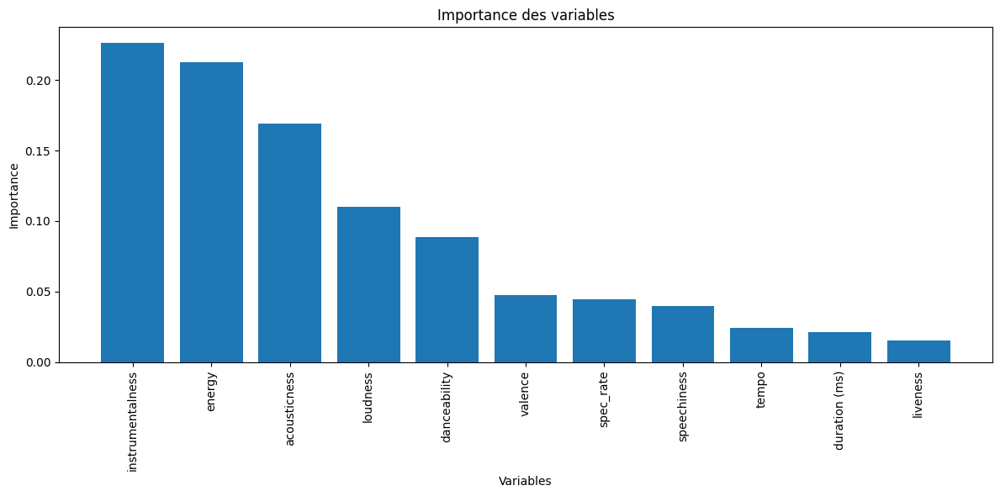

In [26]:
importances = model.feature_importances_
indices = np.argsort(importances)[::-1]
features = X.columns
plt.figure(figsize=(12, 6))
plt.bar(range(len(importances)), importances[indices], align='center')
plt.xticks(range(len(importances)), features[indices], rotation=90)
plt.title("Importance des variables")
plt.xlabel("Variables")
plt.ylabel("Importance")
plt.tight_layout()
plt.show()